In [2]:
import zipfile
with zipfile.ZipFile('new_version_data.zip', 'r') as zip_ref:
    zip_ref.extractall('dataset')

In [3]:
import warnings
warnings.filterwarnings('ignore')

In [4]:
import tensorflow as tf
import os
import random
import numpy as np

from tqdm import tqdm 

from skimage.io import imread, imshow
from skimage.transform import resize
import matplotlib.pyplot as plt

import cv2



In [5]:
from keras import backend as K

def iou_coef(val_y, tst):
  axes = (1,2)
  intersection = np.sum(np.logical_and(tst,val_y), axis=axes)
  # intersection = np.sum(np.abs(y_pred * y_true), axis=axes)
  union = np.sum(np.logical_or(tst,val_y), axis=axes)
  mask_sum = np.sum(np.abs(val_y)) + np.sum(np.abs(tst), axis=axes)
  # union = mask_sum  - intersection
  smooth = .001
  iou = (intersection + smooth) / (union + smooth)
  iou = np.mean(iou)
  return iou

def dice_coef(val_y, tst):
  axes = (1,2)
  intersection = np.sum(np.logical_and(tst,val_y), axis=axes)
  # intersection = np.sum(np.abs(y_pred * y_true), axis=axes)
  union = np.sum(np.logical_or(tst,val_y), axis=axes)
  mask_sum = np.sum(np.abs(val_y)) + np.sum(np.abs(tst), axis=axes)
  # union = mask_sum  - intersection
  smooth = .001
  dice = 2 * (intersection + smooth)/(mask_sum + smooth)
  dice = np.mean(dice)
  return dice

In [6]:
!pip install segmentation_models

     |████████████████████████████████| 51kB 4.8MB/s 


In [7]:
%env SM_FRAMEWORK=tf.keras
import segmentation_models as sm

env: SM_FRAMEWORK=tf.keras
Segmentation Models: using `tf.keras` framework.


In [8]:
os.listdir('dataset/new_version_data/PLDM')

['masks', 'aug_images', 'aug_masks', 'images']

In [9]:
BACKBONE = 'resnet34'
preprocess_input = sm.get_preprocessing(BACKBONE)

# PLDM Data Analysis

In [11]:
seed = 42
np.random.seed = seed

IMG_WIDTH = 128
IMG_HEIGHT = 128
IMG_CHANNELS = 3

TRAIN_PATH_x = 'dataset/new_version_data/PLDM/aug_images'
TRAIN_PATH_y = 'dataset/new_version_data/PLDM/aug_masks'
# TEST_PATH = 'stage1_test/'
sub_feat = sorted(os.listdir(TRAIN_PATH_x))
sub_label = sorted(os.listdir(TRAIN_PATH_y))
# train_ids = next(os.walk(TRAIN_PATH))[1]
# test_ids = next(os.walk(TEST_PATH))[1]

X_train = np.zeros((len(sub_feat), IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS),dtype=np.uint8)
Y_train = np.zeros((len(sub_label), IMG_HEIGHT, IMG_WIDTH,1),dtype = np.uint8)


In [12]:
for i in range(len(sub_feat)):
    img = imread(TRAIN_PATH_x+'/'+sub_feat[i])
    img = resize(img, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
    X_train[i] = img
    
    img2 = imread(TRAIN_PATH_y+'/'+sub_label[i])
    img2 = resize(img2, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
    Y_train[i] = img2[:,:,1].reshape(img2[:,:,1].shape[0],img2[:,:,1].shape[1],1)

In [13]:
from sklearn.model_selection import train_test_split

train_x,val_x,train_y,val_y = train_test_split(X_train,Y_train,test_size = 0.25) 

In [14]:
train_x = preprocess_input(train_x)
val_x = preprocess_input(val_x)

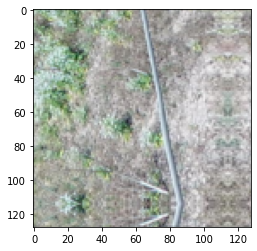

In [15]:
import matplotlib.pyplot as plt
plt.imshow(train_x[0])

In [16]:
train_y = train_y / 255.

In [17]:
model = sm.Unet(BACKBONE)
model.compile(optimizer='adam', loss = 'binary_crossentropy',metrics=['AUC'])

85524480/85521592 [==============================] - 4s 0us/step


In [18]:
results = model.fit(np.asarray(train_x).astype(np.float32),
                    np.asarray(train_y).astype(np.float32), validation_split=0.2 , verbose=2, epochs=30)

Epoch 1/30
12/12 - 46s - loss: 0.5403 - auc: 0.5448 - val_loss: 1.7111 - val_auc: 0.5384
Epoch 2/30
12/12 - 5s - loss: 0.2835 - auc: 0.6180 - val_loss: 2.7680 - val_auc: 0.4538
Epoch 3/30
12/12 - 5s - loss: 0.1809 - auc: 0.7163 - val_loss: 0.7373 - val_auc: 0.4713
Epoch 4/30
12/12 - 5s - loss: 0.1252 - auc: 0.7940 - val_loss: 0.4532 - val_auc: 0.4454
Epoch 5/30
12/12 - 5s - loss: 0.0967 - auc: 0.8769 - val_loss: 0.3705 - val_auc: 0.4485
Epoch 6/30
12/12 - 5s - loss: 0.0790 - auc: 0.9374 - val_loss: 0.7245 - val_auc: 0.6011
Epoch 7/30
12/12 - 5s - loss: 0.0678 - auc: 0.9575 - val_loss: 0.5506 - val_auc: 0.7911
Epoch 8/30
12/12 - 5s - loss: 0.0593 - auc: 0.9649 - val_loss: 0.1969 - val_auc: 0.9159
Epoch 9/30
12/12 - 5s - loss: 0.0553 - auc: 0.9637 - val_loss: 0.1292 - val_auc: 0.8911
Epoch 10/30
12/12 - 5s - loss: 0.0499 - auc: 0.9712 - val_loss: 0.0990 - val_auc: 0.9209
Epoch 11/30
12/12 - 5s - loss: 0.0459 - auc: 0.9725 - val_loss: 0.0837 - val_auc: 0.9268
Epoch 12/30
12/12 - 5s - loss

In [19]:
tst = model.predict(val_x)

In [20]:
tst.shape

(150, 128, 128, 1)

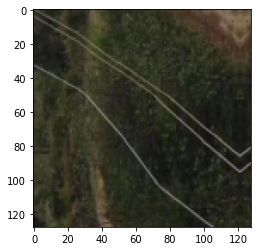

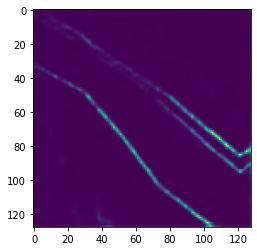

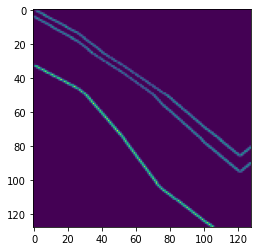

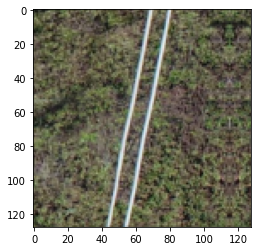

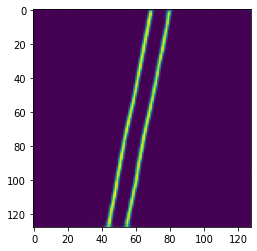

...

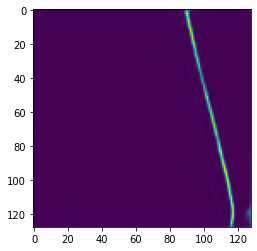

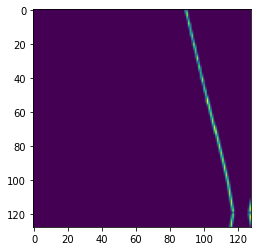

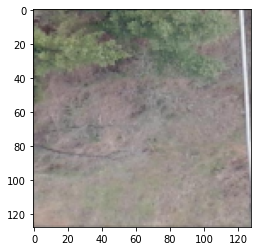

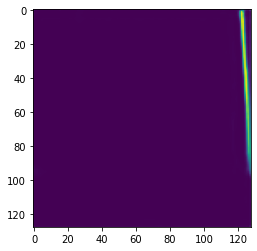

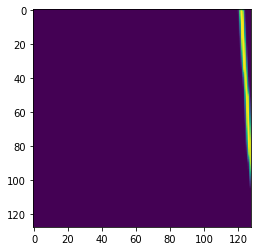

In [21]:
for i in range(len(val_x)):
  plt.imshow(val_x[i])
  plt.show()
  plt.imshow(tst[i][:,:,0])
  plt.show()
  plt.imshow(val_y[i][:,:,0])
  plt.show()


In [22]:
idx = np.random.choice(range(len(val_x)),10)

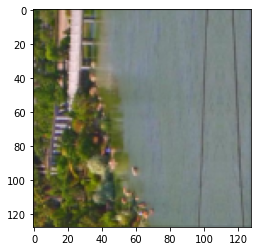

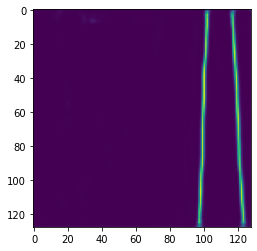

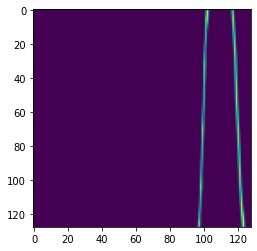

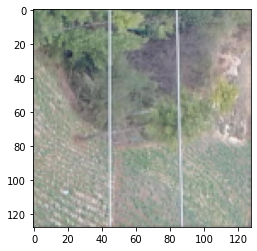

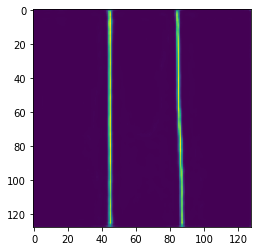

...

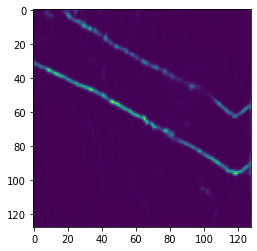

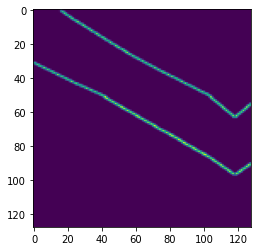

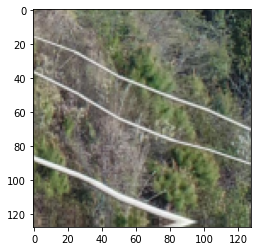

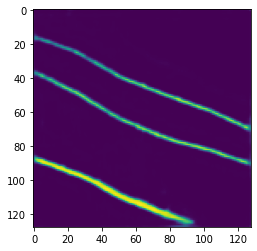

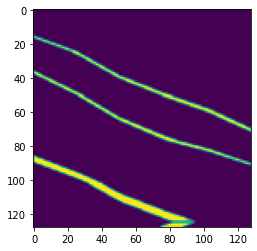

In [23]:
for i in idx:
  plt.imshow(val_x[i])
  plt.show()
  plt.imshow(tst[i][:,:,0])
  plt.show()
  plt.imshow(val_y[i][:,:,0])
  plt.show()


In [24]:
print('Intersection over union coefficient for U-Net model PLDM ',iou_coef(val_y, tst))
print('Intersection over union coefficient for U-Net model PLDM ',dice_coef(val_y,tst))

Intersection over union coefficient for U-Net model PLDM  0.051956844973337094
Intersection over union coefficient for U-Net model PLDM  0.00012791779675609663


In [25]:
model2 = sm.FPN(backbone_name=BACKBONE,input_shape=(128,128,3),classes=1)

model2.compile(optimizer='adam', loss = 'binary_crossentropy',metrics=['AUC'])

In [26]:
results = model2.fit(np.asarray(train_x).astype(np.float32),
                    np.asarray(train_y).astype(np.float32), validation_split=0.2 , verbose=2, epochs=30)

Epoch 1/30
12/12 - 23s - loss: 0.3863 - auc: 0.5000 - val_loss: 0.8960 - val_auc: 0.5000
Epoch 2/30
12/12 - 8s - loss: 0.0994 - auc: 0.5000 - val_loss: 0.4267 - val_auc: 0.5000
Epoch 3/30
12/12 - 8s - loss: 0.0817 - auc: 0.5000 - val_loss: 0.5581 - val_auc: 0.5000
Epoch 4/30
12/12 - 8s - loss: 0.0651 - auc: 0.5000 - val_loss: 0.4388 - val_auc: 0.5000
Epoch 5/30
12/12 - 8s - loss: 0.0539 - auc: 0.5000 - val_loss: 0.1485 - val_auc: 0.5000
Epoch 6/30
12/12 - 8s - loss: 0.0463 - auc: 0.5000 - val_loss: 0.1251 - val_auc: 0.5000
Epoch 7/30
12/12 - 8s - loss: 0.0409 - auc: 0.5000 - val_loss: 0.0921 - val_auc: 0.5000
Epoch 8/30
12/12 - 8s - loss: 0.0365 - auc: 0.5000 - val_loss: 0.0544 - val_auc: 0.5000
Epoch 9/30
12/12 - 8s - loss: 0.0340 - auc: 0.5000 - val_loss: 0.0479 - val_auc: 0.5000
Epoch 10/30
12/12 - 8s - loss: 0.0328 - auc: 0.5000 - val_loss: 0.0446 - val_auc: 0.5000
Epoch 11/30
12/12 - 8s - loss: 0.0320 - auc: 0.5000 - val_loss: 0.0424 - val_auc: 0.5000
Epoch 12/30
12/12 - 8s - loss

In [27]:
tst = model2.predict(val_x)

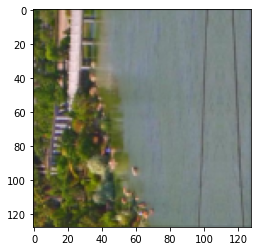

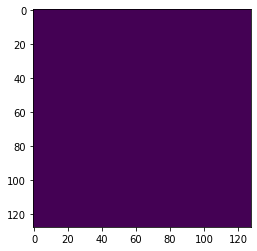

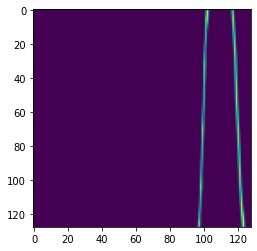

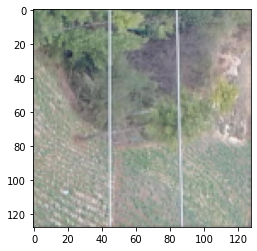

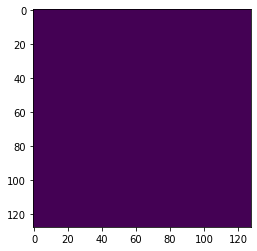

...

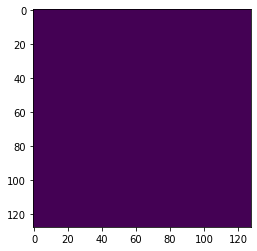

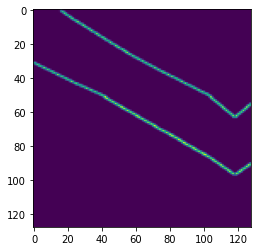

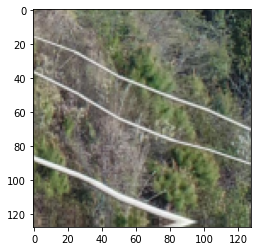

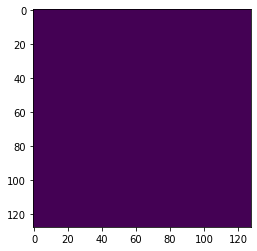

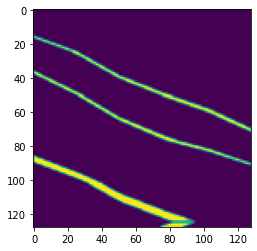

In [28]:
for i in idx:
  plt.imshow(val_x[i])
  plt.show()
  plt.imshow(tst[i][:,:,0])
  plt.show()
  plt.imshow(val_y[i][:,:,0])
  plt.show()

In [29]:
print('Intersection over union coefficient for FPN model PLDM ',iou_coef(val_y, tst))
print('Intersection over union coefficient for FPN model PLDM ',dice_coef(val_y,tst))

Intersection over union coefficient for FPN model PLDM  0.051956844973337094
Intersection over union coefficient for FPN model PLDM  0.00012776390465102903


In [30]:
model3 = sm.Linknet(backbone_name=BACKBONE,input_shape=(128,128,3),classes=1)

model3.compile(optimizer='adam', loss = 'binary_crossentropy',metrics=['AUC'])

In [31]:
results = model3.fit(np.asarray(train_x).astype(np.float32),
                    np.asarray(train_y).astype(np.float32), validation_split=0.2 , verbose=2, epochs=30)

Epoch 1/30
12/12 - 13s - loss: 0.6269 - auc: 0.5347 - val_loss: 1.5205 - val_auc: 0.4590
Epoch 2/30
12/12 - 5s - loss: 0.3633 - auc: 0.5910 - val_loss: 1.4241 - val_auc: 0.4537
Epoch 3/30
12/12 - 4s - loss: 0.2189 - auc: 0.6413 - val_loss: 0.6682 - val_auc: 0.4266
Epoch 4/30
12/12 - 4s - loss: 0.1509 - auc: 0.7573 - val_loss: 0.5172 - val_auc: 0.4383
Epoch 5/30
12/12 - 4s - loss: 0.1165 - auc: 0.8369 - val_loss: 0.3772 - val_auc: 0.4306
Epoch 6/30
12/12 - 4s - loss: 0.0970 - auc: 0.8781 - val_loss: 0.2553 - val_auc: 0.4027
Epoch 7/30
12/12 - 4s - loss: 0.0823 - auc: 0.9178 - val_loss: 0.2737 - val_auc: 0.4232
Epoch 8/30
12/12 - 4s - loss: 0.0727 - auc: 0.9341 - val_loss: 0.2636 - val_auc: 0.5853
Epoch 9/30
12/12 - 4s - loss: 0.0653 - auc: 0.9472 - val_loss: 0.2027 - val_auc: 0.7543
Epoch 10/30
12/12 - 5s - loss: 0.0603 - auc: 0.9540 - val_loss: 0.1456 - val_auc: 0.8210
Epoch 11/30
12/12 - 4s - loss: 0.0564 - auc: 0.9596 - val_loss: 0.1177 - val_auc: 0.8927
Epoch 12/30
12/12 - 4s - loss

In [32]:
tst = model3.predict(val_x)

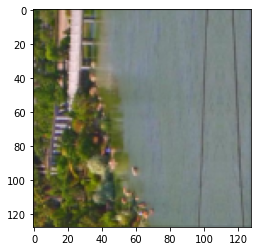

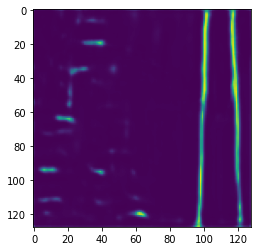

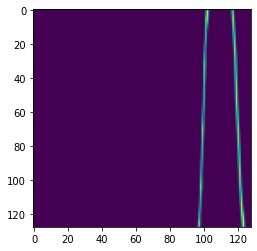

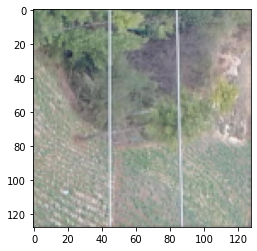

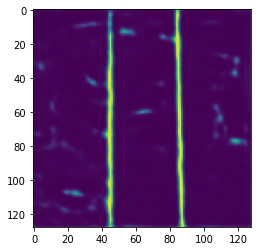

...

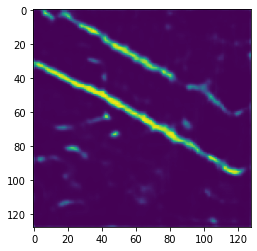

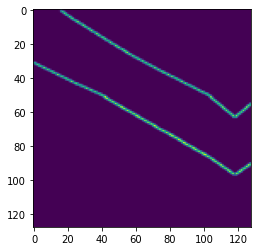

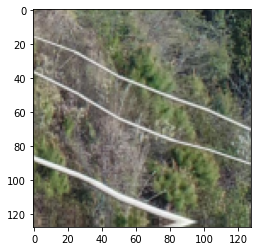

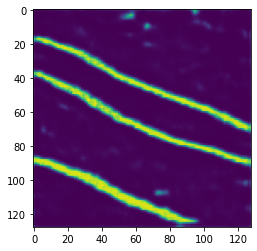

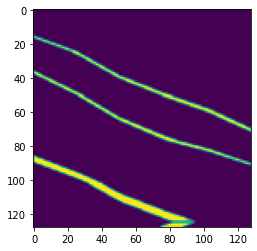

In [33]:
for i in idx:
  plt.imshow(val_x[i])
  plt.show()
  plt.imshow(tst[i][:,:,0])
  plt.show()
  plt.imshow(val_y[i][:,:,0])
  plt.show()

In [34]:
print('Intersection over union coefficient for Linknet model PLDM ',iou_coef(val_y, tst))
print('Intersection over union coefficient for Linknet model PLDM ',dice_coef(val_y,tst))

Intersection over union coefficient for Linknet model PLDM  0.051956844973337094
Intersection over union coefficient for Linknet model PLDM  0.00012791638670174062


# PLDU dataset

In [36]:
seed = 42
np.random.seed = seed

IMG_WIDTH = 128
IMG_HEIGHT = 128
IMG_CHANNELS = 3

TRAIN_PATH_x = 'dataset/new_version_data/PLDU/aug_images'
TRAIN_PATH_y = 'dataset/new_version_data/PLDU/aug_masks'
# TEST_PATH = 'stage1_test/'
sub_feat = sorted(os.listdir(TRAIN_PATH_x))
sub_label = sorted(os.listdir(TRAIN_PATH_y))
# train_ids = next(os.walk(TRAIN_PATH))[1]
# test_ids = next(os.walk(TEST_PATH))[1]

X_train = np.zeros((len(sub_feat), IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS),dtype=np.uint8)
Y_train = np.zeros((len(sub_label), IMG_HEIGHT, IMG_WIDTH,1),dtype = np.uint8)


In [37]:
for i in range(len(sub_feat)):
    img = imread(TRAIN_PATH_x+'/'+sub_feat[i])
    img = resize(img, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
    X_train[i] = img
    
    img2 = imread(TRAIN_PATH_y+'/'+sub_label[i])
    img2 = resize(img2, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
    Y_train[i] = img2[:,:,1].reshape(img2[:,:,1].shape[0],img2[:,:,1].shape[1],1)

In [38]:
from sklearn.model_selection import train_test_split

train_x,val_x,train_y,val_y = train_test_split(X_train,Y_train,test_size = 0.25) 

In [39]:
train_x = preprocess_input(train_x)
val_x = preprocess_input(val_x)

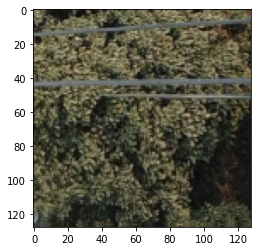

In [40]:
import matplotlib.pyplot as plt
plt.imshow(train_x[0])

In [41]:
train_y = train_y / 255.

In [47]:
model = sm.Unet(BACKBONE)
model.compile(optimizer='adam', loss = 'binary_crossentropy',metrics=['AUC'])

In [48]:
results = model.fit(np.asarray(train_x).astype(np.float32),
                    np.asarray(train_y).astype(np.float32), validation_split=0.2 , verbose=2, epochs=25)

Epoch 1/25
38/38 - 23s - loss: 0.3807 - auc: 0.6638 - val_loss: 145.2103 - val_auc: 0.4821
Epoch 2/25
38/38 - 17s - loss: 0.1424 - auc: 0.9503 - val_loss: 299.7899 - val_auc: 0.5154
Epoch 3/25
38/38 - 17s - loss: 0.0942 - auc: 0.9706 - val_loss: 0.2747 - val_auc: 0.8799
Epoch 4/25
38/38 - 17s - loss: 0.0764 - auc: 0.9790 - val_loss: 0.1195 - val_auc: 0.9395
Epoch 5/25
38/38 - 17s - loss: 0.0680 - auc: 0.9841 - val_loss: 0.1235 - val_auc: 0.9413
Epoch 6/25
38/38 - 16s - loss: 0.0607 - auc: 0.9881 - val_loss: 0.1078 - val_auc: 0.9553
Epoch 7/25
38/38 - 16s - loss: 0.0563 - auc: 0.9904 - val_loss: 0.0840 - val_auc: 0.9776
Epoch 8/25
38/38 - 17s - loss: 0.0526 - auc: 0.9921 - val_loss: 0.0618 - val_auc: 0.9911
Epoch 9/25
38/38 - 17s - loss: 0.0507 - auc: 0.9927 - val_loss: 0.0618 - val_auc: 0.9904
Epoch 10/25
38/38 - 16s - loss: 0.0520 - auc: 0.9913 - val_loss: 0.1825 - val_auc: 0.9106
Epoch 11/25
38/38 - 16s - loss: 0.0531 - auc: 0.9897 - val_loss: 0.0782 - val_auc: 0.9824
Epoch 12/25
38/

In [49]:
idx = np.random.choice(range(len(val_x)),10)

In [50]:
tst = model.predict(val_x)

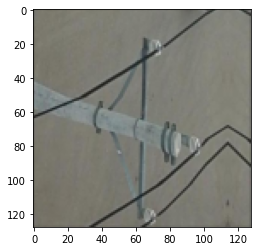

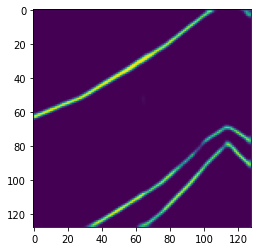

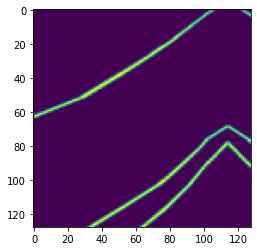

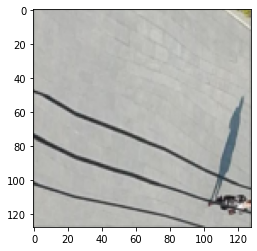

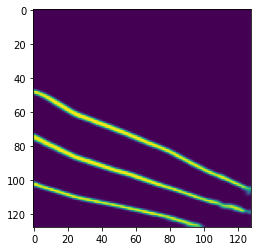

...

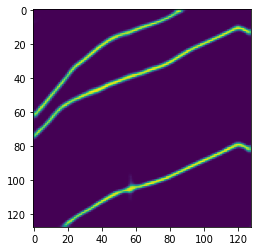

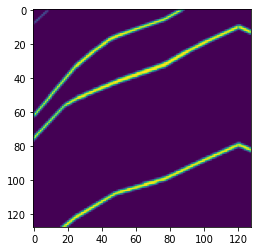

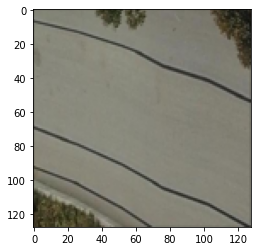

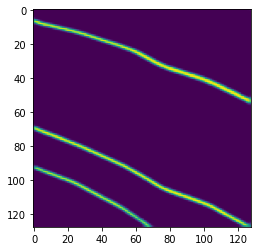

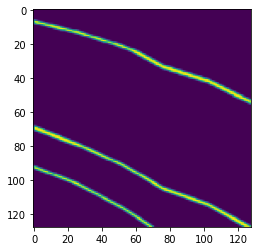

In [51]:
for i in idx:
  plt.imshow(val_x[i])
  plt.show()
  plt.imshow(tst[i][:,:,0])
  plt.show()
  plt.imshow(val_y[i][:,:,0])
  plt.show()

In [52]:
print('Intersection over union coefficient for U-Net model PLDU ',iou_coef(val_y, tst))
print('Intersection over union coefficient for U-Net model PLDU ',dice_coef(val_y,tst))

Intersection over union coefficient for U-Net model PLDU  0.09207634011168411
Intersection over union coefficient for U-Net model PLDU  2.7257500171977403e-05


In [53]:
model2 = sm.FPN(backbone_name=BACKBONE,input_shape=(128,128,3),classes=1)

model2.compile(optimizer='adam', loss = 'binary_crossentropy',metrics=['AUC'])
results = model2.fit(np.asarray(train_x).astype(np.float32),
                    np.asarray(train_y).astype(np.float32), validation_split=0.2 , verbose=2, epochs=25)

Epoch 1/25
38/38 - 37s - loss: 0.1887 - auc: 0.5000 - val_loss: 0.1640 - val_auc: 0.5000
Epoch 2/25
38/38 - 27s - loss: 0.0775 - auc: 0.5000 - val_loss: 0.1056 - val_auc: 0.5000
Epoch 3/25
38/38 - 27s - loss: 0.0629 - auc: 0.5000 - val_loss: 0.0722 - val_auc: 0.5000
Epoch 4/25
38/38 - 27s - loss: 0.0566 - auc: 0.5000 - val_loss: 0.0640 - val_auc: 0.5000
Epoch 5/25
38/38 - 27s - loss: 0.0512 - auc: 0.5000 - val_loss: 0.0568 - val_auc: 0.5000
Epoch 6/25
38/38 - 27s - loss: 0.0475 - auc: 0.5000 - val_loss: 0.0525 - val_auc: 0.5000
Epoch 7/25
38/38 - 27s - loss: 0.0464 - auc: 0.5000 - val_loss: 0.0516 - val_auc: 0.5000
Epoch 8/25
38/38 - 27s - loss: 0.0451 - auc: 0.5000 - val_loss: 0.0510 - val_auc: 0.5000
Epoch 9/25
38/38 - 27s - loss: 0.0427 - auc: 0.5000 - val_loss: 0.0469 - val_auc: 0.5000
Epoch 10/25
38/38 - 27s - loss: 0.0410 - auc: 0.5000 - val_loss: 0.0458 - val_auc: 0.5000
Epoch 11/25
38/38 - 27s - loss: 0.0406 - auc: 0.5000 - val_loss: 0.0451 - val_auc: 0.5000
Epoch 12/25
38/38 -

In [54]:
tst = model2.predict(val_x)

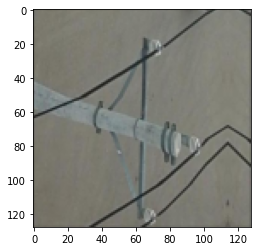

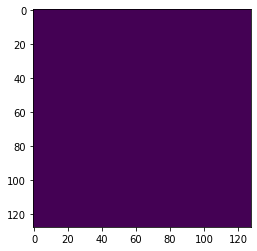

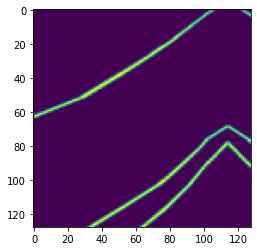

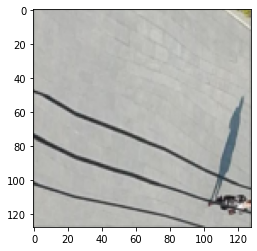

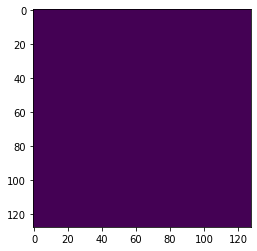

...

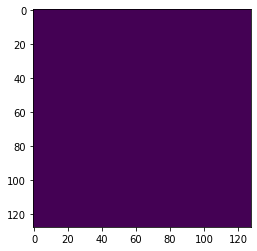

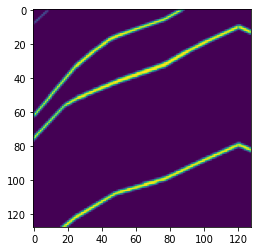

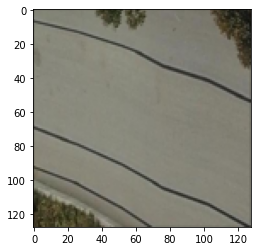

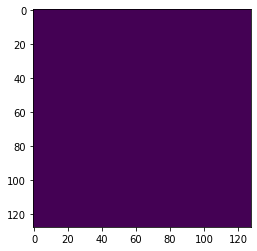

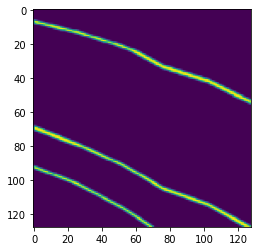

In [55]:
for i in idx:
  plt.imshow(val_x[i])
  plt.show()
  plt.imshow(tst[i][:,:,0])
  plt.show()
  plt.imshow(val_y[i][:,:,0])
  plt.show()

In [56]:
print('Intersection over union coefficient for FPN model PLDU ',iou_coef(val_y, tst))
print('Intersection over union coefficient for FPN model PLDU ',dice_coef(val_y,tst))

Intersection over union coefficient for FPN model PLDU  0.09207512865752389
Intersection over union coefficient for FPN model PLDU  2.7253467140661048e-05


In [60]:
model3 = sm.Linknet(backbone_name=BACKBONE,input_shape=(128,128,3),classes=1)

model3.compile(optimizer='adam', loss = 'binary_crossentropy',metrics=['AUC'])

In [61]:
results = model3.fit(np.asarray(train_x).astype(np.float32),
                    np.asarray(train_y).astype(np.float32), validation_split=0.2 , verbose=2, epochs=25)

Epoch 1/25
38/38 - 22s - loss: 0.4362 - auc: 0.6903 - val_loss: 1.7537 - val_auc: 0.4959
Epoch 2/25
38/38 - 15s - loss: 0.1828 - auc: 0.9110 - val_loss: 0.7356 - val_auc: 0.6991
Epoch 3/25
38/38 - 15s - loss: 0.1210 - auc: 0.9569 - val_loss: 0.1899 - val_auc: 0.7979
Epoch 4/25
38/38 - 15s - loss: 0.0932 - auc: 0.9741 - val_loss: 0.1311 - val_auc: 0.9506
Epoch 5/25
38/38 - 15s - loss: 0.0780 - auc: 0.9805 - val_loss: 0.9588 - val_auc: 0.8317
Epoch 6/25
38/38 - 15s - loss: 0.0734 - auc: 0.9822 - val_loss: 2.3567 - val_auc: 0.7895
Epoch 7/25
38/38 - 15s - loss: 0.0682 - auc: 0.9844 - val_loss: 33.2507 - val_auc: 0.7413
Epoch 8/25
38/38 - 15s - loss: 0.0656 - auc: 0.9845 - val_loss: 0.0929 - val_auc: 0.9700
Epoch 9/25
38/38 - 15s - loss: 0.0616 - auc: 0.9876 - val_loss: 0.0679 - val_auc: 0.9855
Epoch 10/25
38/38 - 15s - loss: 0.0578 - auc: 0.9896 - val_loss: 0.2034 - val_auc: 0.9457
Epoch 11/25
38/38 - 15s - loss: 0.0593 - auc: 0.9880 - val_loss: 0.0708 - val_auc: 0.9778
Epoch 12/25
38/38 

In [62]:
tst = model3.predict(val_x)

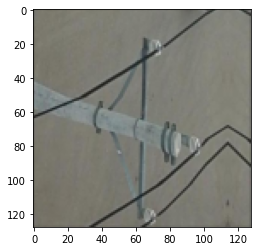

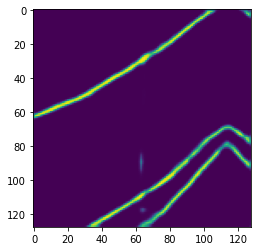

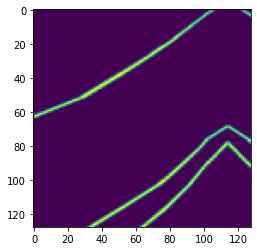

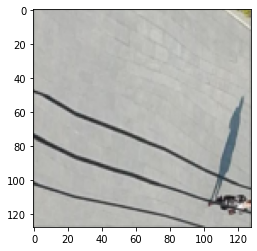

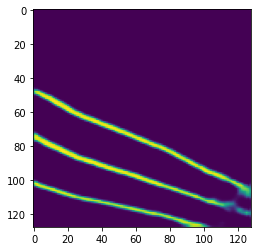

...

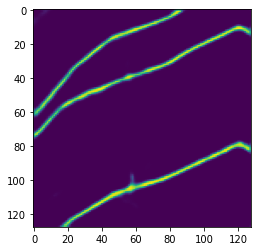

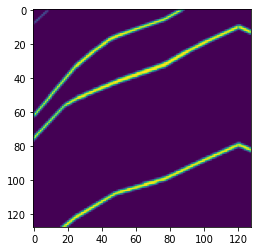

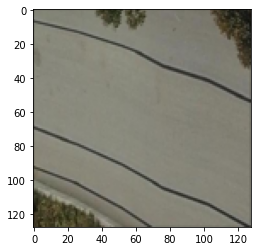

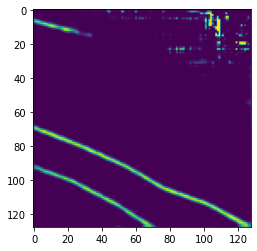

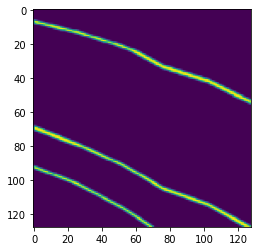

In [63]:
for i in idx:
  plt.imshow(val_x[i])
  plt.show()
  plt.imshow(tst[i][:,:,0])
  plt.show()
  plt.imshow(val_y[i][:,:,0])
  plt.show()

In [64]:
print('Intersection over union coefficient for LinkNet model PLDU ',iou_coef(val_y, tst))
print('Intersection over union coefficient for Linknet model PLDU ',dice_coef(val_y,tst))

Intersection over union coefficient for LinkNet model PLDU  0.09207578015251927
Intersection over union coefficient for Linknet model PLDU  2.725725175087495e-05


# Testing on the whole set (PLDM and PLDU mixed)

In [65]:
pldu_data_x = 'dataset/new_version_data/PLDU/aug_images'
pldm_data_x = 'dataset/new_version_data/PLDM/aug_images'

pldu_data_y = 'dataset/new_version_data/PLDU/aug_masks'
pldm_data_y = 'dataset/new_version_data/PLDM/aug_masks'

In [66]:
pldm_sub_feat = sorted(os.listdir(pldm_data_x))
pldu_sub_feat = sorted(os.listdir(pldu_data_x))

pldm_sub_label = sorted(os.listdir(pldm_data_y))
pldu_sub_label = sorted(os.listdir(pldu_data_y))

In [69]:
X_train_pldm = np.zeros((len(pldm_sub_feat), IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS),dtype=np.uint8)
Y_train_pldm = np.zeros((len(pldm_sub_label), IMG_HEIGHT, IMG_WIDTH,1),dtype = np.uint8)

In [70]:
for i in range(len(pldm_sub_feat)):
    img = imread(TRAIN_PATH_x+'/'+pldm_sub_feat[i])
    img = resize(img, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
    X_train_pldm[i] = img
    
    img2 = imread(TRAIN_PATH_y+'/'+pldm_sub_label[i])
    img2 = resize(img2, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
    Y_train_pldm[i] = img2[:,:,1].reshape(img2[:,:,1].shape[0],img2[:,:,1].shape[1],1)

In [71]:
X_train_pldu = np.zeros((len(pldu_sub_feat), IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS),dtype=np.uint8)
Y_train_pldu = np.zeros((len(pldu_sub_label), IMG_HEIGHT, IMG_WIDTH,1),dtype = np.uint8)

In [72]:
for i in range(len(pldu_sub_feat)):
    img = imread(TRAIN_PATH_x+'/'+pldu_sub_feat[i])
    img = resize(img, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
    X_train_pldu[i] = img
    
    img2 = imread(TRAIN_PATH_y+'/'+pldu_sub_label[i])
    img2 = resize(img2, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
    Y_train_pldu[i] = img2[:,:,1].reshape(img2[:,:,1].shape[0],img2[:,:,1].shape[1],1)

In [75]:
full_X_train = np.vstack((X_train_pldm,X_train_pldu))
full_y_train = np.vstack((Y_train_pldm,Y_train_pldu))

In [80]:
from sklearn.model_selection import train_test_split

train_x,val_x,train_y,val_y = train_test_split(full_X_train,full_y_train,test_size = 0.25) 


In [81]:
train_x = preprocess_input(train_x)
val_x = preprocess_input(val_x)

In [82]:
train_y = train_y / 255.

In [84]:
model = sm.Unet(BACKBONE)
model.compile(optimizer='adam', loss = 'binary_crossentropy',metrics=['AUC'])
results = model.fit(np.asarray(train_x).astype(np.float32),
                    np.asarray(train_y).astype(np.float32), validation_split=0.2 , verbose=2, epochs=25)

Epoch 1/25
49/49 - 28s - loss: 0.3285 - auc: 0.7813 - val_loss: 0.4292 - val_auc: 0.7588
Epoch 2/25
49/49 - 21s - loss: 0.1089 - auc: 0.9626 - val_loss: 0.6173 - val_auc: 0.6744
Epoch 3/25
49/49 - 21s - loss: 0.0787 - auc: 0.9771 - val_loss: 0.6950 - val_auc: 0.7420
Epoch 4/25
49/49 - 22s - loss: 0.0681 - auc: 0.9828 - val_loss: 0.2225 - val_auc: 0.8387
Epoch 5/25
49/49 - 21s - loss: 0.0612 - auc: 0.9870 - val_loss: 0.7702 - val_auc: 0.8334
Epoch 6/25
49/49 - 21s - loss: 0.0563 - auc: 0.9894 - val_loss: 0.2026 - val_auc: 0.9637
Epoch 7/25
49/49 - 21s - loss: 0.0531 - auc: 0.9906 - val_loss: 0.0622 - val_auc: 0.9881
Epoch 8/25
49/49 - 22s - loss: 0.0503 - auc: 0.9919 - val_loss: 0.0888 - val_auc: 0.9729
Epoch 9/25
49/49 - 21s - loss: 0.0537 - auc: 0.9889 - val_loss: 0.0717 - val_auc: 0.9771
Epoch 10/25
49/49 - 21s - loss: 0.0481 - auc: 0.9922 - val_loss: 0.0520 - val_auc: 0.9878
Epoch 11/25
49/49 - 21s - loss: 0.0462 - auc: 0.9927 - val_loss: 0.0493 - val_auc: 0.9891
Epoch 12/25
49/49 -

In [85]:
tst = model.predict(val_x)

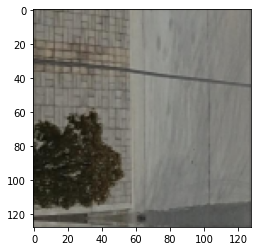

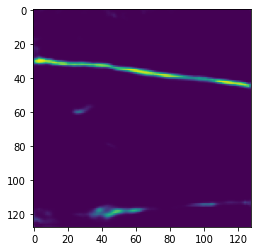

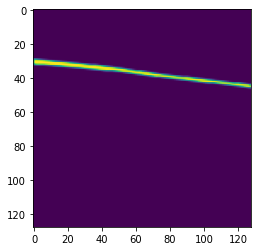

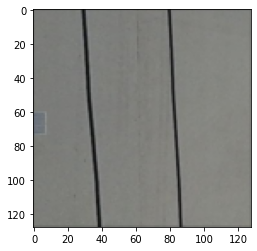

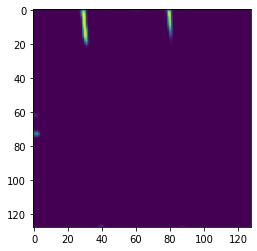

...

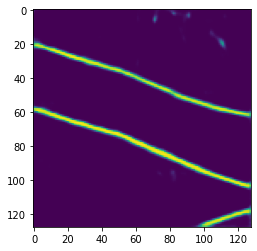

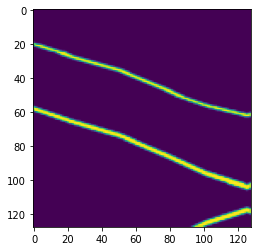

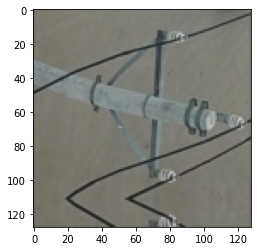

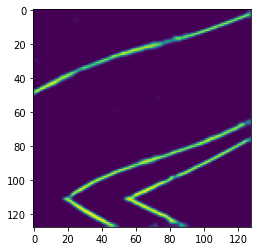

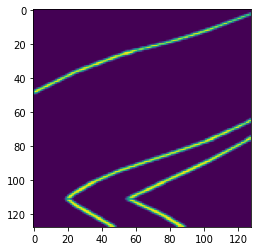

In [86]:
for i in idx:
  plt.imshow(val_x[i])
  plt.show()
  plt.imshow(tst[i][:,:,0])
  plt.show()
  plt.imshow(val_y[i][:,:,0])
  plt.show()

In [87]:
print('Intersection over union coefficient for U-Net model for whole dataset ',iou_coef(val_y, tst))
print('Intersection over union coefficient for U-Net model for whole dataset ',dice_coef(val_y,tst))

Intersection over union coefficient for U-Net model for whole dataset  0.09520175294084855
Intersection over union coefficient for U-Net model for whole dataset  2.083107719441782e-05


In [89]:
model2 = sm.FPN(backbone_name='resnet18',input_shape=(128,128,3),classes=1)

model2.compile(optimizer='adam', loss = 'binary_crossentropy',metrics=['AUC'])
results = model2.fit(np.asarray(train_x).astype(np.float32),
                    np.asarray(train_y).astype(np.float32), validation_split=0.2 , verbose=2, epochs=25)

44924928/44920640 [==============================] - 2s 0us/step
Epoch 1/25
49/49 - 36s - loss: 0.1763 - auc: 0.5000 - val_loss: 0.2541 - val_auc: 0.5000
Epoch 2/25
49/49 - 31s - loss: 0.0774 - auc: 0.5000 - val_loss: 0.1226 - val_auc: 0.5000
Epoch 3/25
49/49 - 30s - loss: 0.0628 - auc: 0.5000 - val_loss: 0.0711 - val_auc: 0.5000
Epoch 4/25
49/49 - 30s - loss: 0.0550 - auc: 0.5000 - val_loss: 0.0593 - val_auc: 0.5000
Epoch 5/25
49/49 - 31s - loss: 0.0502 - auc: 0.5000 - val_loss: 0.0545 - val_auc: 0.5000
Epoch 6/25
49/49 - 30s - loss: 0.0480 - auc: 0.5000 - val_loss: 0.0503 - val_auc: 0.5000
Epoch 7/25
49/49 - 30s - loss: 0.0452 - auc: 0.5000 - val_loss: 0.0486 - val_auc: 0.5000
Epoch 8/25
49/49 - 30s - loss: 0.0435 - auc: 0.5000 - val_loss: 0.0515 - val_auc: 0.5000
Epoch 9/25
49/49 - 30s - loss: 0.0420 - auc: 0.5000 - val_loss: 0.0441 - val_auc: 0.5000
Epoch 10/25
49/49 - 31s - loss: 0.0412 - auc: 0.5000 - val_loss: 0.0433 - val_auc: 0.5000
Epoch 11/25
49/49 - 30s - loss: 0.0398 - auc

In [90]:
tst = model2.predict(val_x)

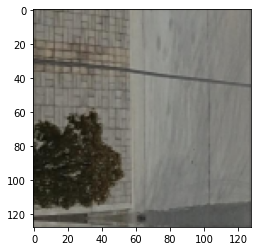

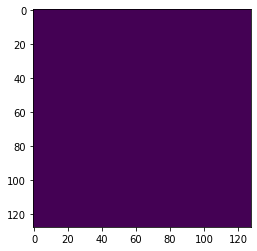

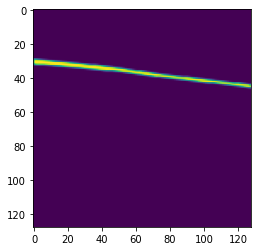

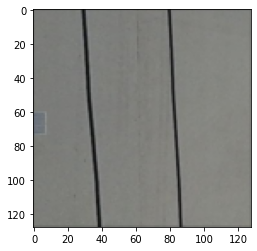

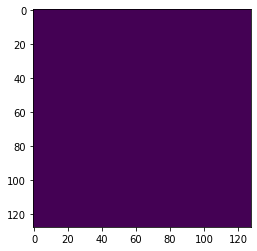

...

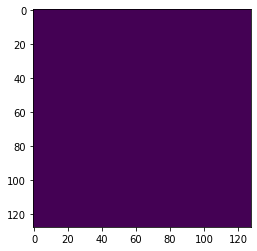

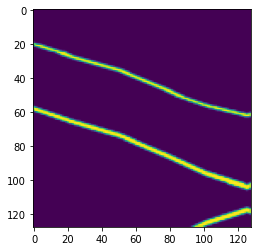

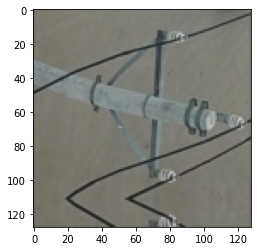

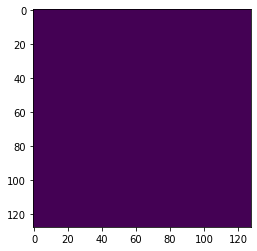

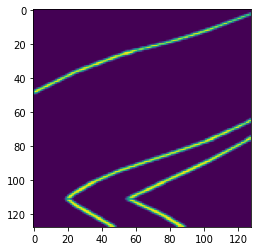

In [91]:
for i in idx:
  plt.imshow(val_x[i])
  plt.show()
  plt.imshow(tst[i][:,:,0])
  plt.show()
  plt.imshow(val_y[i][:,:,0])
  plt.show()

In [92]:
print('Intersection over union coefficient for FPN model for whole dataset ',iou_coef(val_y, tst))
print('Intersection over union coefficient for FPN model for whole dataset ',dice_coef(val_y,tst))

Intersection over union coefficient for FPN model for whole dataset  0.09520175294084855
Intersection over union coefficient for FPN model for whole dataset  2.0828949148848565e-05


In [93]:
model3 = sm.Linknet(backbone_name=BACKBONE,input_shape=(128,128,3),classes=1)

model3.compile(optimizer='adam', loss = 'binary_crossentropy',metrics=['AUC'])
results = model3.fit(np.asarray(train_x).astype(np.float32),
                    np.asarray(train_y).astype(np.float32), validation_split=0.2 , verbose=1, epochs=25)

Epoch 1/25
49/49 [==============================] - 28s 435ms/step - loss: 0.5422 - auc: 0.5680 - val_loss: 7.0227 - val_auc: 0.5111
Epoch 2/25
49/49 [==============================] - 19s 397ms/step - loss: 0.1473 - auc: 0.9419 - val_loss: 0.6964 - val_auc: 0.8092
Epoch 3/25
49/49 [==============================] - 19s 396ms/step - loss: 0.0896 - auc: 0.9755 - val_loss: 0.1252 - val_auc: 0.9744
Epoch 4/25
49/49 [==============================] - 19s 396ms/step - loss: 0.0726 - auc: 0.9839 - val_loss: 0.0861 - val_auc: 0.9765
Epoch 5/25
49/49 [==============================] - 19s 395ms/step - loss: 0.0655 - auc: 0.9874 - val_loss: 0.0677 - val_auc: 0.9879
Epoch 6/25
49/49 [==============================] - 19s 396ms/step - loss: 0.0589 - auc: 0.9903 - val_loss: 0.0854 - val_auc: 0.9719
Epoch 7/25
49/49 [==============================] - 19s 395ms/step - loss: 0.0543 - auc: 0.9920 - val_loss: 0.0565 - val_auc: 0.9906
Epoch 8/25
49/49 [==============================] - 19s 395ms/step - 

In [94]:
tst = model3.predict(val_x)

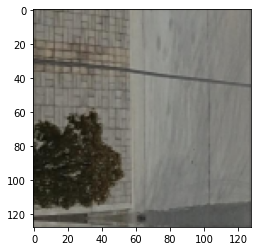

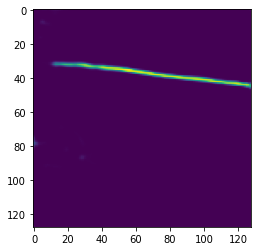

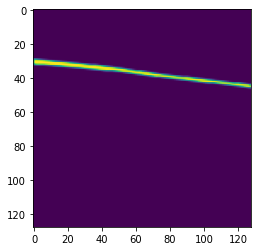

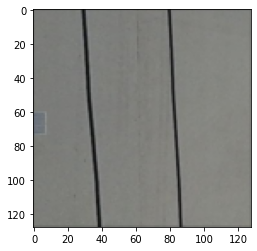

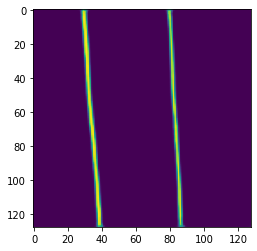

...

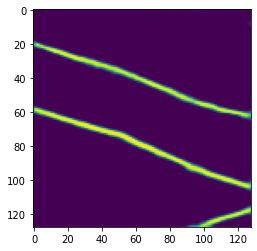

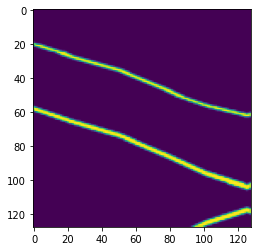

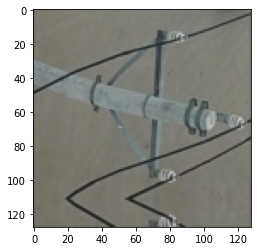

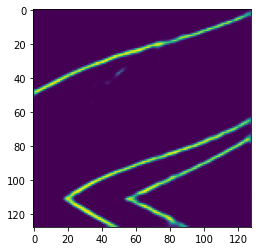

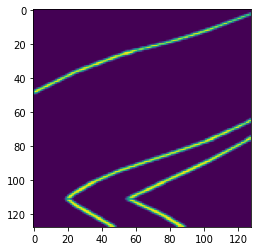

In [95]:
for i in idx:
  plt.imshow(val_x[i])
  plt.show()
  plt.imshow(tst[i][:,:,0])
  plt.show()
  plt.imshow(val_y[i][:,:,0])
  plt.show()

In [96]:
print('Intersection over union coefficient for LinkNet model for the whole data ',iou_coef(val_y, tst))
print('Intersection over union coefficient for Linknet model for the whole data ',dice_coef(val_y,tst))

Intersection over union coefficient for LinkNet model for the whole data  0.09520175294084855
Intersection over union coefficient for Linknet model for the whole data  2.0831082717405436e-05
